## Accessing Landsat Collection 2 Level-1 and Level-2 data with the Planetary Computer STAC API

Code is adapted from the Microsoft Planetary Computer example code at https://planetarycomputer.microsoft.com/dataset/landsat-c2-l2


In [5]:
import pystac_client
import planetary_computer
import odc.stac
import matplotlib.pyplot as plt
import os

from pystac.extensions.eo import EOExtension as eo

### Data access

The datasets hosted by the Planetary Computer are available from [Azure Blob Storage](https://docs.microsoft.com/en-us/azure/storage/blobs/). We'll use [pystac-client](https://pystac-client.readthedocs.io/) to search the Planetary Computer's [STAC API](https://planetarycomputer.microsoft.com/api/stac/v1/docs) for the subset of the data that we care about, and then we'll load the data directly from Azure Blob Storage. We'll specify a `modifier` so that we can access the data stored in the Planetary Computer's private Blob Storage Containers. See [Reading from the STAC API](https://planetarycomputer.microsoft.com/docs/quickstarts/reading-stac/) and [Using tokens for data access](https://planetarycomputer.microsoft.com/docs/concepts/sas/) for more.

In [6]:
catalog = pystac_client.Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1",
    modifier=planetary_computer.sign_inplace,
)

### Choose an area and time of interest

This bounding box is a small area near the Kaikoura peninsula. I'm just using it to find the correct tiles.
Our time of interest is from 2015 (for a pre-earthquake baseline) through to the end of 2024. We'll look at all imagery with cloud cover less than 10%

In [2]:
bbox_of_interest = [173, -42, 173.5, -41.5]
time_of_interest = "2015-01-01/2024-12-31"

In [7]:
search = catalog.search(
    collections=["landsat-c2-l2"],
    bbox=bbox_of_interest,
    datetime=time_of_interest,
    query={"eo:cloud_cover": {"lt": 10}},
)

items = search.item_collection()
print(f"Returned {len(items)} Items")
items

Returned 102 Items


In [8]:
items[0].datetime

datetime.datetime(2024, 2, 29, 22, 7, 23, 348002, tzinfo=tzutc())

In [9]:
# Extract a list of selected images that we can refer to from other notebooks

print(items[0].datetime)
print(items[0].assets['nir08'].href.split('/')[10])
print(items[0].assets['red'].href.split('/')[10])

out_fn = os.path.join('../1-raw-data/ndvi/autoselected_images.txt')

with open(out_fn, 'w') as f:
    for i in items:
        if i.assets['nir08'].href.split('/')[10] == i.assets['red'].href.split('/')[10]:
            output = [str(i.datetime), i.assets['nir08'].href.split('/')[10]]
            f.write(','.join(output) + '\n')
        else:
            print('help!')

2024-02-29 22:07:23.348002+00:00
LC09_L2SP_073089_20240229_20240301_02_T1
LC09_L2SP_073089_20240229_20240301_02_T1


### Check that everything is working

In [10]:
selected_item = items[1]

print(
    f"Choosing {selected_item.id} from {selected_item.datetime.date()}"
    + f" with {selected_item.properties['eo:cloud_cover']}% cloud cover"
)


Choosing LC08_L2SP_073089_20240221_02_T1 from 2024-02-21 with 2.35% cloud cover


In [11]:
max_key_length = len(max(selected_item.assets, key=len))
for key, asset in selected_item.assets.items():
    print(f"{key.rjust(max_key_length)}: {asset.title}")

              qa: Surface Temperature Quality Assessment Band
             ang: Angle Coefficients File
             red: Red Band
            blue: Blue Band
            drad: Downwelled Radiance Band
            emis: Emissivity Band
            emsd: Emissivity Standard Deviation Band
            trad: Thermal Radiance Band
            urad: Upwelled Radiance Band
           atran: Atmospheric Transmittance Band
           cdist: Cloud Distance Band
           green: Green Band
           nir08: Near Infrared Band 0.8
          lwir11: Surface Temperature Band
          swir16: Short-wave Infrared Band 1.6
          swir22: Short-wave Infrared Band 2.2
         coastal: Coastal/Aerosol Band
         mtl.txt: Product Metadata File (txt)
         mtl.xml: Product Metadata File (xml)
        mtl.json: Product Metadata File (json)
        qa_pixel: Pixel Quality Assessment Band
       qa_radsat: Radiometric Saturation and Terrain Occlusion Quality Assessment Band
      qa_aerosol: Aeros

### Render a natural color image of the AOI

We'll start by loading the red, green, and blue bands for our area of interest into an xarray dataset using [`odc-stac`](https://pypi.org/project/odc-stac/). We will also load the nir08 band for use in computing an NDVI value in a later example. Note that we pass the `sign` function from the [planetary-computer](https://github.com/microsoft/planetary-computer-sdk-for-python) package so that `odc-stac` can supply the required [Shared Access Signature](https://docs.microsoft.com/en-us/azure/storage/common/storage-sas-overview) tokens that are necessary to download the asset data.

In [12]:
bands_of_interest = ["nir08", "red", "green", "blue", "qa_pixel", "lwir11"]
data = odc.stac.stac_load(
    [selected_item], bands=bands_of_interest, #bbox=bbox_of_interest
).isel(time=0)
data

<xarray.Dataset> Size: 773MB
Dimensions:      (y: 8041, x: 8011)
Coordinates:
  * y            (y) float64 64kB -4.507e+06 -4.507e+06 ... -4.748e+06
  * x            (x) float64 64kB 6.216e+05 6.216e+05 ... 8.619e+05 8.619e+05
    spatial_ref  int32 4B 32659
    time         datetime64[ns] 8B 2024-02-21T22:07:17.333506
Data variables:
    nir08        (y, x) uint16 129MB 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0
    red          (y, x) uint16 129MB 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0
    green        (y, x) uint16 129MB 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0
    blue         (y, x) uint16 129MB 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0
    qa_pixel     (y, x) uint16 129MB 1 1 1 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1 1 1 1
    lwir11       (y, x) uint16 129MB 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0

Now we'll convert our xarray Dataset to a DataArray and plot the RGB image. We set `robust=True` in `imshow` to avoid manual computation of the color limits (vmin and vmax) that is necessary for data not scaled to between 0-1 while also eliminating extreme values that can cause a washed out image.

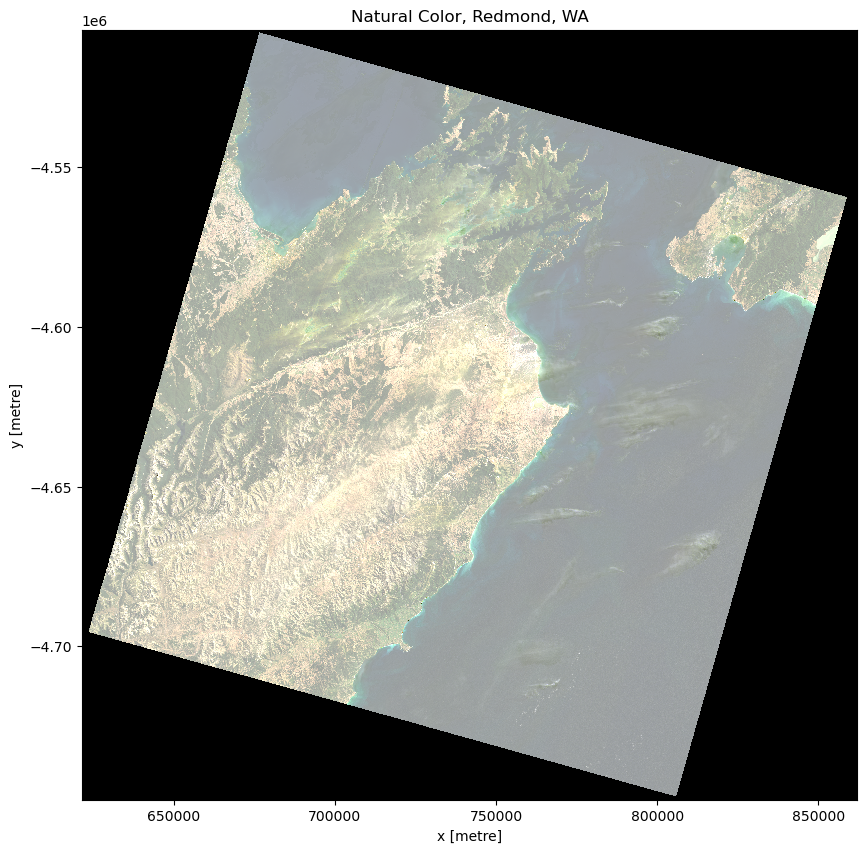

In [13]:
fig, ax = plt.subplots(figsize=(10, 10))

data[["red", "green", "blue"]].to_array().plot.imshow(robust=True, ax=ax)
ax.set_title("Natural Color, Redmond, WA");

### Render an NDVI image of the AOI

Landsat has several bands, and with them we can go beyond rendering natural color imagery; for example, the following code computes a [Normalized Difference Vegetation Index (NDVI)](https://en.wikipedia.org/wiki/Normalized_difference_vegetation_index) using the near-infrared and red bands. Note that we convert the red and near infrared bands to a data type that can contain negative values; if this is not done, negative NDVI values will be incorrectly stored.

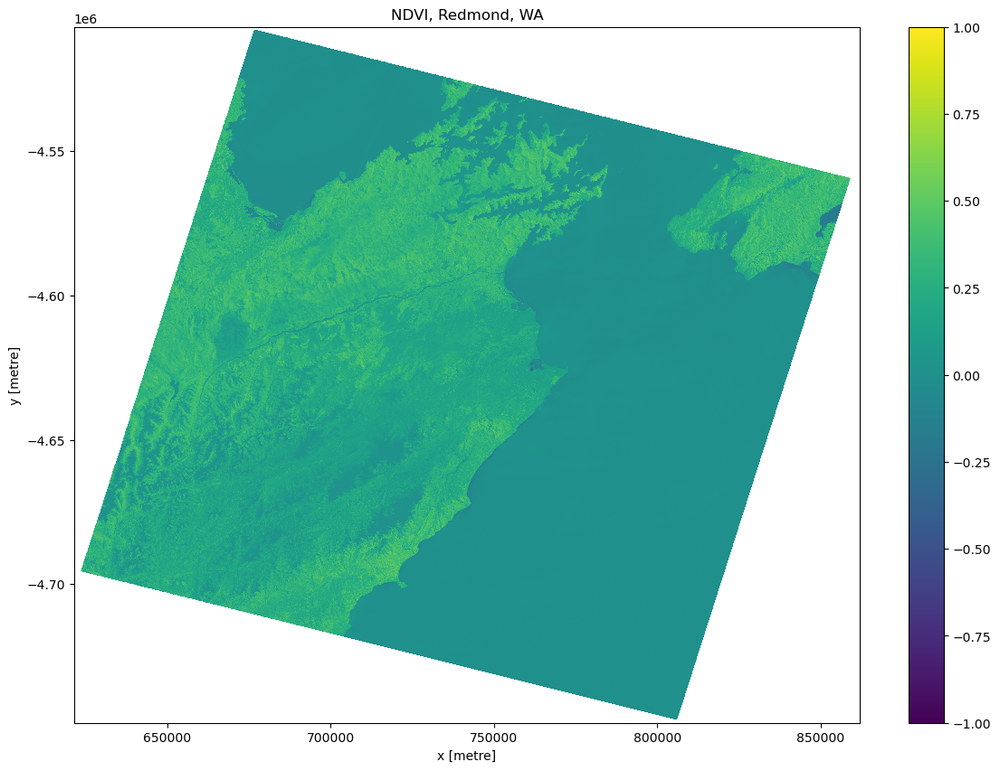

In [14]:
red = data["red"].astype("float")
nir = data["nir08"].astype("float")
ndvi = (nir - red) / (nir + red)

fig, ax = plt.subplots(figsize=(14, 10))
ndvi.plot.imshow(ax=ax, cmap="viridis")
ax.set_title("NDVI, Redmond, WA");

In [15]:
import rasterio as rio
img_folder = "../1-raw-data/ndvi/"

test_src = rio.open(img_folder + "LC08_L2SP_073089_20231219_20240103_02_T1_ndvi.TIF")
ndvi_crs = test_src.crs
r = test_src.read(1, masked=True).astype('float')


kwargs = test_src.meta

out_fn = os.path.join(img_folder, 'test.TIF')
with rio.open(out_fn, 'w', **kwargs) as dst:
    dst.write(ndvi.astype(rio.float32),1)
print("done")


done


### Download all images taken between October and December

In [16]:
for i in items:

    if i.datetime.month > 9:
        print(i.assets['nir08'].href.split('/')[10])
        out_fn = os.path.join(img_folder, i.assets['nir08'].href.split('/')[10] + "_ndvi.TIF")


        if not os.path.exists(out_fn):
            bands_of_interest = ["nir08", "red"]
            data = odc.stac.stac_load(
                [i], bands=bands_of_interest, #bbox=bbox_of_interest
            ).isel(time=0)

            red = data["red"].astype("float")
            nir = data["nir08"].astype("float")
            ndvi = (nir - red) / (nir + red)

            with rio.open(out_fn, 'w', **kwargs) as dst:
                dst.write(ndvi.astype(rio.float32),1)
            print("done")





LC08_L2SP_073089_20231219_20240103_02_T1
LE07_L2SP_074089_20231210_20240105_02_T1
LC09_L2SP_073089_20231125_20231128_02_T1
LC08_L2SP_073089_20221114_20221122_02_T1
LC09_L2SP_073089_20221106_20221110_02_T1
LE07_L2SP_073089_20221104_20221130_02_T1
LE07_L2SP_073089_20201202_20201229_02_T1
LE07_L2SP_073089_20201031_20201127_02_T1
LC08_L2SP_073089_20201023_20201105_02_T1
LE07_L2SP_073089_20201015_20201111_02_T1
LC08_L2SP_073089_20191208_20200824_02_T1
LC08_L2SP_073089_20191005_20200825_02_T1
LE07_L2SP_073089_20181111_20200827_02_T1
LC08_L2SP_073089_20181018_20200830_02_T1
LE07_L2SP_073089_20171210_20200830_02_T1
LC08_L2SP_073089_20171202_20200902_02_T1
LE07_L2SP_073089_20171108_20200830_02_T1
LC08_L2SP_073089_20161215_20200905_02_T1
LE07_L2SP_073089_20161121_20200901_02_T1
LC08_L2SP_073089_20161012_20200905_02_T1
LE07_L2SP_074089_20151228_20200903_02_T1
LC08_L2SP_073089_20151213_20200908_02_T1
LC08_L2SP_073089_20151010_20200908_02_T1
LE07_L2SP_073089_20151002_20200903_02_T1


In [17]:
ndvi

<xarray.DataArray (y: 8041, x: 8011)> Size: 515MB
array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])
Coordinates:
  * y            (y) float64 64kB -4.507e+06 -4.507e+06 ... -4.748e+06
  * x            (x) float64 64kB 6.216e+05 6.216e+05 ... 8.619e+05 8.619e+05
    spatial_ref  int32 4B 32659
    time         datetime64[ns] 8B 2024-02-21T22:07:17.333506